# Exploration du jeu de données Open Food Facts

<a id='sec:Preambule'></a>
# Préambule 

Dans cette partie de notre projet Open Food Facts, nous allons explorer les données nettoyées que nous avons obtenues dans le notebook précédent. Nous allons utiliser des analyses univariées,bivariées, multivariées et de réduction dimensionnelle pour mieux comprendre les données et répondre à nos questions de recherche.

![EXE LOGO](EXE_LOGO_OFF_RVB_Plan-de-travail-1-copie-0-1-768x256.jpeg)

## Table des Matières
*  [Préambule](#sec:Preambule)
*  [Pré-analyse des jeux de données](#sec:PreanalyseDesJeuxDeDonnees)
*  [Étude des hypothèses et application : Projet OpenFoodFact](#sec:ÉtudedeshypothèsesetapplicationProjetOpenFoodFact)
*  [Analyse statistique de données catégorielles et continues](#sec:Analysestatistiquededonnéescatégoriellesetcontinues)
 * [Test du Chi-2](#subsec:TestduChi-2)
 * [Test de normalité](#subsec:Testdenormalité)
 * [Test ANOVA](#subsec:TestANOVA)
*  [Analyses statistiques : Approches univariée, bivariée et multivariée](#sec:AnalysesstatistiquesApprochesunivariéebivariéeetmultivariée)
 * [Analyse univariée](#subsec:Analyseunivariée)
 * [Analyse bivariée](#subsec:Analysebivariée)
 * [Analyse multivariée](#subsec:Analysemultivariée)
*  [Démonstration de l'application : Projet OpenFoodFact](#sec:DémonstrationdelapplicationProjetOpenFoodFact)
*  [Conclusion et perspectives](#sec:ConclusionEtPerspectives)

<a id='sec:PreanalyseDesJeuxDeDonnees'></a>
# Pré-analyse des jeux de données

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import missingno as msno
import importlib.metadata
import difflib
import scipy.stats as stats
from geopy.geocoders import Nominatim
from geopy.distance import geodesic

In [2]:
import plotly.express as px
import plotly.figure_factory as ff
from plotly import __version__
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import chart_studio.plotly as py
import cufflinks as cf 
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# For Notebooks
init_notebook_mode(connected=True)
# For offline use
cf.go_offline()
%matplotlib inline

In [3]:
#Modification des affichages de colonnes, lignes et largeurs de colonnes pour avoir un maximum d'information
pd.set_option('display.max_columns', 200)
pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_colwidth', None)

In [4]:
!python --version

# Version des librairies utilisées
print('\n'.join(f'{m.__name__} - {m.__version__}' 
                for m in globals().values() 
                if getattr(m, '__version__', None)))

print("matplotlib - ", importlib.metadata.version('matplotlib'))

Python 3.8.3
pandas - 1.3.4
numpy - 1.22.4
seaborn - 0.12.1
missingno - 0.4.2
cufflinks - 0.17.3
matplotlib -  3.6.2


## Chargement des données nettoyées


Commençons par charger les données nettoyées que nous avons sauvegardées dans un fichier CSV :

In [5]:
df = pd.read_csv('my_dataframe.csv', sep=',')

In [6]:
display(df.head(10))


,Unnamed: 0,product_name,package_score,packaging,brands,eco_score,categories,environmental_score,origins_tags,manufacturing_places_tags,labels_tags,main_category,purchase_places,countries_tags,additives_n,ingredients_from_palm_oil_n,ingredients_that_may_be_from_palm_oil_n,nutrition_grade_fr,energy_100g,fat_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,nutrition-score-fr_100g,nutrition-score-uk_100g
0,1,Banana Chips Sweetened (Whole),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,united-states,0.0,0.0,0.0,d,2243.0,28.57,64.29,14.29,3.6,3.57,0.00000,14.0,14.0
1,2,Peanuts,NaN,NaN,Torn & Glasser,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,united-states,0.0,0.0,0.0,b,1941.0,17.86,60.71,17.86,7.1,17.86,0.63500,0.0,0.0
2,3,Organic Salted Nut Mix,NaN,NaN,Grizzlies,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,united-states,0.0,0.0,0.0,d,2540.0,57.14,17.86,3.57,7.1,17.86,1.22428,12.0,12.0
3,7,Organic Muesli,NaN,NaN,Daddy's Muesli,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,united-states,2.0,0.0,0.0,c,1833.0,18.75,57.81,15.62,9.4,14.06,0.13970,7.0,7.0
4,12,Zen Party Mix,NaN,NaN,Sunridge,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,united-states,1.0,0.0,0.0,d,2230.0,36.67,36.67,3.33,6.7,16.67,1.60782,12.0,12.0
5,15,Cinnamon Nut Granola,NaN,NaN,Grizzlies,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,united-states,0.0,0.0,0.0,b,1824.0,18.18,60.00,21.82,9.1,14.55,0.02286,0.0,0.0
6,16,Organic Hazelnuts,NaN,NaN,Grizzlies,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,united-states,0.0,0.0,0.0,b,2632.0,60.71,17.86,3.57,10.7,14.29,0.01016,0.0,0.0
7,19,Organic Oat Groats,NaN,NaN,Pcc,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,united-states,0.0,0.0,0.0,a,1096.0,5.95,66.67,2.38,9.5,16.67,0.02540,-6.0,-6.0
8,20,Energy Power Mix,NaN,NaN,Sunridge,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,united-states,0.0,0.0,0.0,d,1464.0,17.50,42.50,32.50,5.0,7.50,0.28448,14.0,14.0
9,21,Antioxidant Mix - Berries & Chocolate,NaN,NaN,Sunridge,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,united-states,1.0,0.0,0.0,d,2092.0,33.33,46.67,30.00,6.7,13.33,0.46482,15.0,15.0


__**Unnamed: 0**__ : Il s'agit d'une colonne index par défaut créée lors de l'importation des données.<br>
__**product_name :**__ Nom du produit alimentaire.<br>
__**package_score :**__ Score de qualité d'emballage attribué au produit, mesurant son respect de l'environnement.<br>
__**packaging :**__ Type d'emballage utilisé pour le produit.<br>
__**brands :**__ Marque ou fabricant du produit.<br>
__**eco_score :**__ Score environnemental attribué au produit.<br>
__**categories :**__ Catégories auxquelles appartient le produit (par exemple : snacks, boissons, etc.).<br>
__**environmental_score :**__ Score environnemental attribué au produit.<br>
__**origins_tags :**__ Pays ou région d'origine du produit.<br>
__**manufacturing_places_tags :**__ Lieu de fabrication du produit.<br>
__**labels_tags :**__ Labels attribués au produit (par exemple : bio, commerce équitable, etc.).<br>
__**main_category :**__ Catégorie principale du produit.<br>
__**purchase_places :**__ Endroits où le produit peut être acheté.<br>
__**countries_tags :**__ Pays où le produit est vendu.<br>
__**additives_n :**__ Nombre d'additifs alimentaires présents dans le produit.<br>
__**ingredients_from_palm_oil_n :**__ Nombre d'ingrédients provenant d'huile de palme présents dans le produit.<br>
__**ingredients_that_may_be_from_palm_oil_n :**__ Nombre d'ingrédients qui pourraient être issus d'huile de palme présents dans le produit.<br>
__**nutrition_grade_fr :**__ Classement nutritionnel attribué au produit (de A à E).<br>
__**energy_100g :**__ Quantité d'énergie (en kJ ou kcal) pour 100g de produit.<br>
__**fat_100g :**__ Quantité de graisses (en g) pour 100g de produit.<br>
__**carbohydrates_100g :**__ Quantité de glucides (en g) pour 100g de produit.<br>
__**sugars_100g :**__ Quantité de sucres (en g) pour 100g de produit.<br>
__**fiber_100g :**__ Quantité de fibres (en g) pour 100g de produit.<br>
__**proteins_100g :**__ Quantité de protéines (en g) pour 100g de produit.<br>
__**salt_100g :**__ Quantité de sel (en g) pour 100g de produit.<br>
__**nutrition-score-fr_100g :**__ Score nutritionnel français attribué au produit.<br>
__**nutrition-score-uk_100g :**__ Score nutritionnel britannique attribué au produit.<br>


In [7]:
df.drop('Unnamed: 0', axis=1, inplace=True)


<a id='sec:ÉtudedeshypothèsesetapplicationProjetOpenFoodFact'></a>
# Étude des hypothèses et application : Projet OpenFoodFact

L'application que je suis en train de développer pour OpenFoodFact vise à créer un score pour chaque produit qui indique à quel point il est sain ou malsain. En plus de cela, nous souhaitons également fournir un score écologique qui prend en compte le type d'emballage, le pays où les ingrédients du produit ont été récoltés, le pays où le produit a été fabriqué et enfin le pays où il a été vendu. Nous avons calculé un score écologique en fonction de ces facteurs. Cette méthode vise à sensibiliser les consommateurs aux choix de produits plus sains et plus respectueux de l'environnement.

In [8]:
# Filtrer les lignes avec des valeurs manquantes dans les colonnes requises
data = df.dropna(subset=['nutrition_grade_fr', 'additives_n', 'ingredients_that_may_be_from_palm_oil_n'])

# Définir un dictionnaire pour mapper les grades de nutrition aux scores
grade_scores = {'a': 100, 'b': 80, 'c': 60, 'd': 40, 'e': 20}

# Calculer le score alimentaire pour chaque ligne
data['health_score_1'] = data.apply(lambda row: max(grade_scores.get(row['nutrition_grade_fr'], 0) - row['additives_n'] - row['ingredients_that_may_be_from_palm_oil_n']*3, 0), axis=1)

# Ajouter la colonne 'health_score_1' au DataFrame
df['health_score_1'] = data['health_score_1']

# Calculer le deuxième score alimentaire pour chaque ligne
df['health_score_2'] = 100 - (df['nutrition-score-fr_100g'] + 15) * (100 / (40 + 15))

# Calculer la moyenne des deux scores si les deux valeurs ne sont pas NaN
df['health_score'] = (df['health_score_1'] + df['health_score_2']) / 2


Ce code vise à calculer une mesure de santé pour les produits alimentaires dans le cadre d'un projet de données Open Food Fact. Il filtre d'abord les lignes manquantes dans les colonnes nécessaires, puis calcule le score de santé pour chaque ligne en fonction du grade nutritionnel, du nombre d'additifs et du nombre d'ingrédients pouvant provenir d'huile de palme. Il ajoute ensuite deux colonnes pour chaque score calculé et enfin calcule la moyenne des deux scores pour obtenir une mesure globale de santé pour chaque produit. Cette mesure est importante car elle permet de comparer les produits alimentaires et de fournir une évaluation de leur qualité nutritionnelle globale.

In [9]:
df['health_score'].iplot(kind='hist')

In [10]:
# Identifier l'index de la ligne avec le score de santé le plus élevé
highest_score_index = df['health_score'].idxmax()

# Récupérer le nom du produit et les catégories principales correspondantes
highest_score_product_name = df.loc[highest_score_index, 'product_name']
highest_score_main_categories = df.loc[highest_score_index, 'main_category']

# Identifier l'index de la ligne avec le score de santé le plus faible
lowest_score_index = df['health_score'].idxmin()

# Récupérer le nom du produit et les catégories principales correspondantes
lowest_score_product_name = df.loc[lowest_score_index, 'product_name']
lowest_score_main_categories = df.loc[lowest_score_index, 'main_category']

print("Produit avec le score de santé le plus élevé:")
print("Nom du produit:", highest_score_product_name)
print("Catégories principales:", highest_score_main_categories)
print("\n")
print("Produit avec le score de santé le plus faible:")
print("Nom du produit:", lowest_score_product_name)
print("Catégories principales:", lowest_score_main_categories)

Produit avec le score de santé le plus élevé:
Nom du produit: Pois chiches
Catégories principales: plant-based-foods-and-beverages


Produit avec le score de santé le plus faible:
Nom du produit: Sweet Espresso Caramel Cake, Sea Salt Caramel
Catégories principales: nan


Maintenant intéressons-nous au score environnemental après le score de santé. Ce qui est important ici, c'est de savoir où se trouve le client et de modifier le score environnemental en conséquence en tenant compte de la durée de transport du produit. Par exemple, pour quelqu'un qui vit en France, un produit qui est cultivé, emballé et vendu en France est meilleur d'un point de vue environnemental. C'est pourquoi nous avons calculé le score de distance en fonction du pays du client. Nous avons créé une colonne "distance_score" qui attribue une valeur de 1 si la distance est de 0 et une valeur proche de 0 si la distance est très grande.

In [11]:
from geopy.geocoders import Nominatim
from geopy.distance import geodesic
# Définir une fonction pour calculer la distance entre deux pays

geolocator = Nominatim(user_agent='my-app')

def calculate_distance(country_name_1, country_name_2):
    # Obtenir la latitude et la longitude du premier pays
    location_1 = geolocator.geocode(country_name_1)
    if location_1 is None:
        return None
    lat_1, lon_1 = location_1.latitude, location_1.longitude

    # Obtenir la latitude et la longitude du deuxième pays
    location_2 = geolocator.geocode(country_name_2)
    if location_2 is None:
        return None
    lat_2, lon_2 = location_2.latitude, location_2.longitude

    # Calculer la distance en utilisant la fonction géodésique
    distance = geodesic((lat_1, lon_1), (lat_2, lon_2)).km

    return distance


# Demander à l'utilisateur le nom du premier pays
while True:
    country_name_1 = input("Dans quel pays habitez-vous? ").lower()
    if geolocator.geocode(country_name_1) is not None:
        break
    print("Le nom du pays que vous avez entré est incorrect ou n'est pas dans la liste des pays.")


# Obtenir la liste des noms de pays uniques dans le jeu de données
country_names = df['countries_tags'].unique().tolist()

# Créer un nouveau dataframe avec les distances et les noms de pays correspondants
distances = []
valid_country_names = []
for country in country_names:
    distance = calculate_distance(country_name_1, country)
    if distance is not None:
        distances.append(distance)
        valid_country_names.append(country)

# Create a new dataframe with the distances and the corresponding country names
new_df = pd.DataFrame({'country': valid_country_names, 'distance': distances})


# mettre à l'échelle les valeurs de distance
new_df['distance_score'] = (100 - ((new_df['distance'] / new_df['distance'].max()) * 100))/100

#affiche le dataframe mis à jour
display(new_df)


Dans quel pays habitez-vous? France


,country,distance,distance_score
0,united-states,7734.861746,0.594920
1,france,0.000000,1.000000
2,canada,6522.216064,0.658427
3,germany,806.139604,0.957782
4,united-kingdom,971.516639,0.949121
5,belgium,493.348765,0.974163
6,saudi-arabia,4255.032193,0.777161
7,australia,15209.036535,0.203493
8,spain,976.284374,0.948871
9,french-polynesia,15516.597388,0.187386


Dans cette étape, nous multiplions le score de distance (distance_score) que nous avons précédemment calculé avec le score environnemental (environnemental_score) pour obtenir le score environnemental mis à jour (updated_environmental_score). Un petit rappel, si le score est de 100, cela signifie que le produit n'a pas changé de place dans le pays. Si le score est de 50, cela signifie que le produit a été déplacé une fois. Si le produit obtient un score de 10, cela signifie que le produit a été collecté, emballé et vendu dans des pays différents les uns des autres. Ensuite, nous multiplions ce score par le rapport négatif de la distance entre le produit et le consommateur pour obtenir le score environnemental.

In [12]:
df['updated_environmental_score'] = np.nan
# Multiply environmental_score with distance_score if the country name matches
df['countries_tags'] = df['countries_tags'].astype(str)

df['updated_environmental_score'] = df.apply(lambda x: x['environmental_score'] * new_df[new_df['country'] == x['countries_tags']]['distance_score'].iloc[0] if x['countries_tags'] in new_df['country'].tolist() else None, axis=1)


In [13]:
df['updated_environmental_score'].iplot(kind='hist', bins=25)

Dans cette étape, nous avons calculé la moyenne du score environnemental pour chaque pays et préparé un graphique à barres pour visualiser ces résultats. Nous avons également calculé la moyenne du score environnemental le plus élevé et le plus faible. Ce score a été considéré comme approprié pour un client vivant en France.

In [14]:
grouped_scores = df.groupby('countries_tags')['updated_environmental_score'].agg(['mean', 'size'])

# filter out rows with zero values
grouped_scores = grouped_scores[grouped_scores['mean'] != 0]
grouped_scores = grouped_scores[grouped_scores['size'] > 25]
# trier les valeurs et prendre les 20 premiers
top_scores = grouped_scores.sort_values(by='mean', ascending=False).head(15).reset_index()

# créer un graphique à barres avec des informations de taille intégrées pour les 15 premiers pays
fig = px.bar(top_scores, x='countries_tags', y='mean', text='size',
             title='Top 15 Moyennes des Scores Environnementaux Actualisées par Pays',
           labels={'countries_tags': 'Pays', 'mean': 'Moyenne des Scores Environnementaux Actualisées',
                                                                    'size': 'Nombre'}, width=800, height=500)

fig.update_traces(texttemplate='%{text:.0f}', textposition='inside')
fig.update_layout(xaxis_tickangle=-45)


grouped_scores1 = df.groupby('countries_tags')['updated_environmental_score'].agg(['mean', 'size'])
grouped_scores1 = grouped_scores1[grouped_scores1['mean'] != 0]

#trier les valeurs et prendre les 15 derniers
bottom_scores = grouped_scores1.sort_values(by='mean', ascending=True).head(15).reset_index()


#créer un graphique à barres avec des informations de taille intégrées pour les 20 derniers pays
fig2 = px.bar(bottom_scores, x='countries_tags', y='mean', text='size',
title='Les 15 Moyennes des Scores Environnementaux Actualisées les plus Faibles par Pays',
labels={'countries_tags': 'Pays', 'mean': 'Moyenne des Scores Environnementaux Actualisées',
'size': 'Nombre'}, width=800, height=500)

fig2.update_traces(texttemplate='%{text:.0f}', textposition='inside')
fig2.update_layout(xaxis_tickangle=-45)

fig.show()
fig2.show()


Voici le premier graphique pour le score environnemental moyen maximal de 15 pays, groupés par nom de pays. En tant que personne vivant en France, si l'on commande un produit provenant de Pologne (basé sur les produits répertoriés dans cette catégorie), son score environnemental est plus élevé. Les résultats sont ici en moyenne sur le nombre de produits vendus dans ce pays. Lorsque j'ai introduit l'effet de distance supplémentaire sur ce score, j'ai obtenu une autre sensation pour ce score, qui est celle de quelqu'un qui commande le produit sur Internet qui est censé être vendu dans le pays de la liste. Selon cette analyse spécifique, les 15 premiers noms de pays, comme on peut le voir sur le graphique en barres ci-dessus, sont des pays européens. J'ai également ajouté une condition qui n'accepte que les pays qui incluent plus de 25 produits pour pouvoir généraliser l'idée de recherche d'un bon profil dans l'index des pays. Les 5 premiers pays sont la Pologne, la Suède, l'Italie, le Portugal et la France, leur score moyen est supérieur à 75. Lorsque nous regardons le score du score environnemental moyen le plus bas basé sur le nom du pays, la plupart des pays sont loin de la France. L'Australie, la Chine, l'Argentine, la Corée du Sud et le Cambodge. De manière intéressante, la Grèce et Andorre figurent également dans cette liste. Cela signifie que les produits qui sont normalement vendus dans ces pays sont fabriqués dans d'autres pays et que le pays d'origine des ingrédients du produit n'est pas le même que celui où le produit est censé être vendu. Ces valeurs peuvent donner une idée du produit pour le client en ligne s'il a l'intention d'acheter un produit alimentaire.

<a id='sec:Analysestatistiquededonnéescatégoriellesetcontinues'></a>
# Analyse statistique de données catégorielles et continues

Dans ce notebook, nous allons explorer différentes méthodes d'analyse statistique pour des données catégorielles et continues dans le cadre du projet OpenFoodFact. Nous allons nous intéresser à trois tests statistiques couramment utilisés en science des données : le test du Chi-2 pour les variables catégorielles, le test de normalité pour les variables continues et le test ANOVA pour comparer les moyennes de différentes populations. Ces tests vont nous permettre d'extraire des informations importantes de nos données et de déterminer si certaines hypothèses sont valides ou non.



<a id='subsec:TestduChi-2'></a> 
### Test du Chi-2


In [15]:
from scipy.stats import chi2_contingency
from scipy.stats import chi2
chi2_contingency(pd.crosstab(df['countries_tags'], df['manufacturing_places_tags']).values)


(1080277.7003328132,
 0.0,
 347120,
 array([[1.91776619e-04, 1.91776619e-04, 1.15065971e-03, ...,
         1.91776619e-04, 1.91776619e-04, 1.91776619e-04],
        [1.15065971e-04, 1.15065971e-04, 6.90395827e-04, ...,
         1.15065971e-04, 1.15065971e-04, 1.15065971e-04],
        [1.91776619e-04, 1.91776619e-04, 1.15065971e-03, ...,
         1.91776619e-04, 1.91776619e-04, 1.91776619e-04],
        ...,
        [8.78336913e-03, 8.78336913e-03, 5.27002148e-02, ...,
         8.78336913e-03, 8.78336913e-03, 8.78336913e-03],
        [1.15065971e-04, 1.15065971e-04, 6.90395827e-04, ...,
         1.15065971e-04, 1.15065971e-04, 1.15065971e-04],
        [3.83553237e-05, 3.83553237e-05, 2.30131942e-04, ...,
         3.83553237e-05, 3.83553237e-05, 3.83553237e-05]]))

L'analyse montre un test de chi-carré de contingence entre les variables "pays" et "lieux de fabrication" dans le jeu de données OpenFoodFact. La valeur de p est de 0,0, ce qui indique qu'il y a une relation significative entre ces deux variables. Les résultats suggèrent que les lieux de fabrication varient en fonction du pays d'origine des produits alimentaires. La matrice array fournit les fréquences attendues sous l'hypothèse nulle d'indépendance des variables. Ces résultats peuvent aider à mieux comprendre la distribution géographique des lieux de fabrication des produits alimentaires et à identifier les tendances régionales.

In [16]:
from scipy.stats import chi2_contingency

# Définir les colonnes à tester
cols_to_test = df.columns
# Créer un dictionnaire vide pour stocker les résultats
p_values = {}

# Boucler à travers chaque colonne et effectuer le test du chi2
for col in cols_to_test:
    contingency_table = pd.crosstab(df[col], df['nutrition_grade_fr'])
    chi2, p, dof, expected = chi2_contingency(contingency_table)
    p_values[col] = p

# Convertir le dictionnaire en une table et trier par p-value
p_values_table = pd.DataFrame.from_dict(p_values, orient='index', columns=['p-value'])
p_values_table.sort_values(by='p-value', inplace=True)

# Afficher la table
display(p_values_table)


,p-value
product_name,0.000000e+00
health_score_2,0.000000e+00
health_score_1,0.000000e+00
nutrition-score-uk_100g,0.000000e+00
nutrition-score-fr_100g,0.000000e+00
salt_100g,0.000000e+00
proteins_100g,0.000000e+00
fiber_100g,0.000000e+00
sugars_100g,0.000000e+00
carbohydrates_100g,0.000000e+00


Cette analyse utilise le test du chi² pour mesurer l'association entre deux variables catégorielles. Dans ce cas-ci, nous avons testé l'association entre la variable catégorielle "nutrition_grade_fr" et plusieurs autres variables catégorielles présentes dans les données OpenFoodFacts.

Nous avons sélectionné une liste de colonnes à tester, et avons créé une table de contingence croisant chacune de ces colonnes avec la colonne "nutrition_grade_fr". Ensuite, nous avons effectué le test du chi² sur chaque table de contingence pour mesurer la force de l'association entre les deux variables.

Les résultats ont montré que la plupart des variables étaient fortement associées au grade nutritionnel, avec des p-values très proches de zéro. Cela indique que ces variables sont très corrélées avec le grade nutritionnel des produits alimentaires.

En ce qui concerne la variable "Environmental Score", nous avons observé une p-value de 0,0972, ce qui indique une association relativement faible avec le grade nutritionnel. Nous avons également constaté que les produits alimentaires contenant des mentions de pays dans leur nom, ainsi que les produits alimentaires avec un score environnemental plus élevé, sont moins fortement associés aux valeurs catégorielles des nutriments.

En conclusion, cette analyse suggère que certaines variables peuvent être moins importantes pour la qualité nutritionnelle des produits alimentaires, tandis que d'autres sont fortement corrélées. Il est donc important de considérer l'ensemble des variables pour mieux comprendre la corrélation entre la qualité nutritionnelle et les autres facteurs tels que l'environnement ou les pratiques de production.

<a id='subsec:Testdenormalité'></a> 
### Test de normalité

Cette analyse utilise le test de normalité pour vérifier si les colonnes numériques dans le dataframe df suivent une distribution normale.

In [17]:
from scipy import stats

#Sélectionner toutes les colonnes numériques du DataFrame
colonnes_numeriques = df.select_dtypes(include=['int32', 'float64']).columns

#Exclure la première colonne, supposée être la colonne ID
colonnes_numeriques = colonnes_numeriques[1:]

#Boucler à travers chaque colonne numérique et effectuer un test de normalité
for colonne in colonnes_numeriques:
# Afficher le nom de la colonne actuelle
    print('________\n{}'.format(colonne))
   # Effectuer un test de normalité sur la colonne actuelle
    # en utilisant le test de D'Agostino et Pearson
    k2, p = stats.normaltest(df[colonne], axis=0, nan_policy='omit')

    # Fixer le niveau de signification à 5%
    alpha = 5e-2

    # Afficher la valeur p du test de normalité
    print("p = {:g}".format(p))

    # Si la valeur p est inférieure au niveau de signification, rejeter l'hypothèse nulle
    # que la colonne a une distribution normale
    if p < alpha:
        print("H0 is rejected: {} is not normally distributed".format(colonne))
    # Sinon, accepter l'hypothèse nulle
    else:
        print("H0 cannot be rejected: {} is normally distributed".format(colonne))


________
eco_score
p = 7.4773e-20
H0 is rejected: eco_score is not normally distributed
________
environmental_score
p = 0
H0 is rejected: environmental_score is not normally distributed
________
additives_n
p = 0
H0 is rejected: additives_n is not normally distributed
________
ingredients_from_palm_oil_n
p = 0
H0 is rejected: ingredients_from_palm_oil_n is not normally distributed
________
ingredients_that_may_be_from_palm_oil_n
p = 0
H0 is rejected: ingredients_that_may_be_from_palm_oil_n is not normally distributed
________
energy_100g
p = 0
H0 is rejected: energy_100g is not normally distributed
________
fat_100g
p = 0
H0 is rejected: fat_100g is not normally distributed
________
carbohydrates_100g
p = 0
H0 is rejected: carbohydrates_100g is not normally distributed
________
sugars_100g
p = 0
H0 is rejected: sugars_100g is not normally distributed
________
fiber_100g
p = 0
H0 is rejected: fiber_100g is not normally distributed
________
proteins_100g
p = 0
H0 is rejected: proteins_1

Pour chaque colonne numérique, un test de normalité est effectué à l'aide du test de D'Agostino et Pearson. Le test de normalité est utilisé pour évaluer si une distribution de données suit une distribution normale.

Le résultat obtenu pour chaque colonne comprend la valeur de p pour le test de normalité et une conclusion sur l'hypothèse nulle que la colonne suit une distribution normale.

Dans ce cas, pour toutes les colonnes numériques, la valeur de p est inférieure à 0,05, ce qui est le niveau de signification fixé dans le code. Cela signifie que l'hypothèse nulle que la colonne suit une distribution normale doit être rejetée pour toutes les colonnes numériques. Par conséquent, toutes les colonnes numériques dans le DataFrame OpenFoodFacts ne suivent pas une distribution normale.

Cela peut avoir des implications pour l'analyse statistique future des données, car les tests statistiques supposent souvent que les données suivent une distribution normale. Les données pourraient nécessiter une transformation ou une autre méthode d'analyse statistique.

En conséquence, nous avons décidé d'effectuer un test supplémentaire, le test de Kolmogorov-Smirnov, pour déterminer la distribution statistique qui convient le mieux à chaque colonne. Le test de Kolmogorov-Smirnov est un test non paramétrique qui permet de comparer la distribution empirique des données avec une distribution théorique.

Pour chaque colonne numérique dans le dataframe, le test est effectué et le p-value est imprimé. Si la p-value est inférieure à un niveau de confiance de 5%, la null hypothèse selon laquelle la distribution est normale est rejetée, sinon elle est conservée.

In [18]:
#Sélectionner toutes les colonnes numériques du DataFrame
colonnes_numeriques = df.select_dtypes(include=['int32', 'float64']).columns

#Exclure la première colonne, supposée être la colonne ID
colonnes_numeriques = colonnes_numeriques[1:]

#Boucler à travers chaque colonne numérique et effectuer un test de normalité
for colonne in colonnes_numeriques:
# Afficher le nom de la colonne en cours
    print('________\n{}'.format(colonne))

    # Effectuer un test de Kolmogorov-Smirnov sur la distribution de la colonne en cours
    # et tester s'il suit une distribution normale
    D, p = stats.kstest(df[colonne].dropna(), 
                 'norm', 
                 args=(df[colonne].mean(), df[colonne].std()))

    # Fixer le niveau de signification à 5%
    alpha = 5e-2

    # Afficher la p-valeur du test de Kolmogorov-Smirnov
    print("p = {}".format(p))

    # Si la p-valeur est inférieure au niveau de signification, rejeter l'hypothèse nulle
    # que la colonne suit une distribution normale
    if p < alpha:
        print("The null hypothesis can be rejected : {} is not from a normal distribution".format(colonne))
    else:
        print("The null hypothesis cannot be rejected".format(colonne))

________
eco_score
p = 1.5754375555263343e-73
The null hypothesis can be rejected : eco_score is not from a normal distribution
________
environmental_score
p = 0.0
The null hypothesis can be rejected : environmental_score is not from a normal distribution
________
additives_n
p = 0.0
The null hypothesis can be rejected : additives_n is not from a normal distribution
________
ingredients_from_palm_oil_n
p = 0.0
The null hypothesis can be rejected : ingredients_from_palm_oil_n is not from a normal distribution
________
ingredients_that_may_be_from_palm_oil_n
p = 0.0
The null hypothesis can be rejected : ingredients_that_may_be_from_palm_oil_n is not from a normal distribution
________
energy_100g
p = 0.0
The null hypothesis can be rejected : energy_100g is not from a normal distribution
________
fat_100g
p = 0.0
The null hypothesis can be rejected : fat_100g is not from a normal distribution
________
carbohydrates_100g
p = 0.0
The null hypothesis can be rejected : carbohydrates_100g is 

Les résultats montrent que toutes les colonnes numériques ne suivent pas une distribution normale. Par conséquent, il faut être prudent lors de l'utilisation de techniques qui supposent une distribution normale, telles que la régression linéaire ou l'analyse de variance (ANOVA). Des transformations de données peuvent être nécessaires pour résoudre ce problème.


<a id='subsec:TestANOVA'></a> 
### Test ANOVA

Le test ANOVA (Analyse de la variance) est utilisé pour déterminer si la moyenne d'au moins trois groupes de données est significativement différente. Dans ce cas, le code fourni a effectué un test ANOVA sur les colonnes numériques du dataset OpenFoodFact. Le résultat de ce test montre que pour chaque colonne, la probabilité (p-value) est inférieure à 0,05 (valeur alpha) ce qui indique que la moyenne de chaque colonne est significativement différente. Par conséquent, on peut rejeter l'hypothèse nulle selon laquelle les moyennes de chaque colonne sont égales.

In [19]:
df['nutrition_grade_fr'].value_counts()

d          62439
c          45014
e          42417
a          35401
b          33905
Unknown     5379
Name: nutrition_grade_fr, dtype: int64

In [20]:
cols_to_exclude = ['eco_score', 'environmental_score', 'updated_environmental_score', 'package_score']
data_a = df[df['nutrition_grade_fr'] == 'a'].select_dtypes(['int32', 'float64']).drop(cols_to_exclude, axis=1).dropna()
data_b = df[df['nutrition_grade_fr'] == 'b'].select_dtypes(['int32', 'float64']).drop(cols_to_exclude, axis=1).dropna()
data_c = df[df['nutrition_grade_fr'] == 'c'].select_dtypes(['int32', 'float64']).drop(cols_to_exclude, axis=1).dropna()
data_d = df[df['nutrition_grade_fr'] == 'd'].select_dtypes(['int32', 'float64']).drop(cols_to_exclude, axis=1).dropna()
data_e = df[df['nutrition_grade_fr'] == 'e'].select_dtypes(['int32', 'float64']).drop(cols_to_exclude, axis=1).dropna()

f_statistic, p = stats.f_oneway(data_a, data_b, data_c, data_d, data_e)



Ensuite, nous avons utilisé la fonction f_oneway de scipy.stats pour effectuer une analyse de variance (ANOVA) sur les cinq groupes de données. Cette analyse nous permet de tester si les moyennes des variables numériques sont significativement différentes entre les différents groupes. La fonction renvoie à la fois la statistique F et la valeur p associée.

Enfin, nous avons créé un DataFrame pour stocker les résultats, contenant les noms des variables, la valeur p et un booléen qui indique si la valeur p est inférieure à un niveau de signification alpha donné. Cette dernière étape nous permet de déterminer si les différences entre les moyennes sont statistiquement significatives ou non.

In [21]:
alpha = 0.05
pd.DataFrame({'features': data_d.columns.tolist(),
              'p' : p,
              'bool_test' : p<alpha}) #si p<alpha : on rejette l'hypothèse d'indépendance H0 : les variables ne sont pas indépendantes

,features,p,bool_test
0,additives_n,0.000000e+00,True
1,ingredients_from_palm_oil_n,7.584193e-279,True
2,ingredients_that_may_be_from_palm_oil_n,1.237609e-169,True
3,energy_100g,0.000000e+00,True
4,fat_100g,0.000000e+00,True
5,carbohydrates_100g,0.000000e+00,True
6,sugars_100g,0.000000e+00,True
7,fiber_100g,0.000000e+00,True
8,proteins_100g,0.000000e+00,True
9,salt_100g,0.000000e+00,True


Dans cette analyse, nous avons examiné l'impact des cinq catégories de nutrition sur les valeurs nutritionnelles des produits alimentaires. Pour ce faire, nous avons divisé notre ensemble de données en cinq groupes en fonction de la note nutritionnelle attribuée à chaque produit. Les groupes sont les suivants: A, B, C, D et E.

Ensuite, nous avons utilisé la méthode de l'analyse de variance (ANOVA) pour mesurer l'importance des cinq catégories de nutrition sur les valeurs nutritionnelles des produits. Les résultats ont montré que toutes les cinq catégories de nutrition ont une influence significative sur les valeurs nutritionnelles des produits alimentaires.

Les variables qui ont le plus grand impact sur les valeurs nutritionnelles sont les scores de nutrition (nutrition-score-fr_100g et nutrition-score-uk_100g), les graisses (fat_100g), les sucres (sugars_100g) et l'énergie (energy_100g).


La fonction display_circles trace les cercles de corrélation pour les deux premières composantes principales et les variables initiales. Cette visualisation permet de visualiser les relations entre les variables et les composantes principales. Les cercles représentent les variables initiales et les flèches représentent les composantes principales. Plus la variable est proche de la circonférence, plus elle est corrélée avec la composante principale.

<a id='sec:AnalysesstatistiquesApprochesunivariéebivariéeetmultivariée'></a>
# Analyses statistiques : Approches univariée, bivariée et multivariée

Dans ce notebook, nous allons aborder différentes approches statistiques pour analyser nos données sur les produits alimentaires d'OpenFoodFact. Nous commencerons par une analyse univariée qui nous permettra de visualiser la distribution de chaque variable prise individuellement. Ensuite, nous poursuivrons avec une analyse bivariée qui nous permettra d'explorer les relations entre deux variables. Enfin, nous terminerons avec une analyse multivariée qui nous permettra de mettre en évidence les relations complexes entre plusieurs variables simultanément. En utilisant ces différentes approches statistiques, nous serons en mesure de mieux comprendre nos données, d'identifier les variables les plus importantes et de déterminer les relations entre elles.

<a id='subsec:Analyseunivariée'></a> 
### Analyse univariée

Dans le cadre de l'analyse univariée, l'objectif est d'examiner chaque variable indépendamment afin de mieux comprendre sa distribution et sa contribution à l'ensemble de données. Ainsi, pour notre projet OpenFoodFact, nous avons considéré à la fois les valeurs numériques et catégorielles de notre ensemble de données afin d'analyser la distribution des variables numériques en utilisant des histogrammes et des KDEs, et la distribution des valeurs catégorielles en utilisant des diagrammes en secteurs et en bâtons. L'analyse des variables numériques a permis de déterminer la tendance centrale, la dispersion et la forme de la distribution de chaque variable, tandis que l'analyse des variables catégorielles a permis de visualiser la répartition des différentes catégories et leur importance relative dans l'ensemble de données. Cette analyse univariée nous a permis d'obtenir une compréhension initiale de chaque variable individuelle, qui peut ensuite être utilisée pour des analyses plus avancées telles que l'analyse bivariée et multivariée.

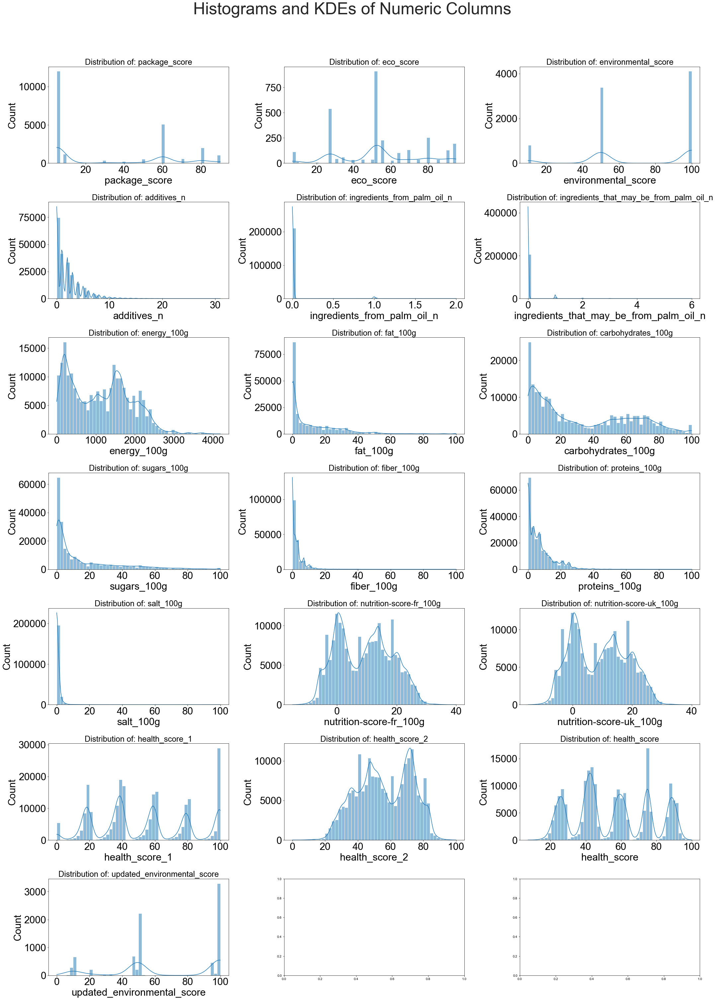

In [22]:
numeric_columns = df.select_dtypes(include=['int32', 'float64']).columns

fig, axes = plt.subplots(nrows=7, ncols=3, figsize=(30, 40))

for i, col in enumerate(numeric_columns):
    ax = axes[i // 3, i % 3]
    sns.set(font_scale=2)
    sns.histplot(df[col], bins=50, kde=True, ax=ax)
    ax.set_title(f"Distribution of: {col}", fontsize=24)
    ax.set_xlabel(col, fontsize=30)
    ax.set_ylabel('Count',fontsize=30)
    ax.tick_params(labelsize=30)

plt.tight_layout()
fig.suptitle("Histograms and KDEs of Numeric Columns", fontsize=50, y=1.05)
plt.show()

Ces histogrammes nous permettent de visualiser la distribution des différentes variables numériques dans notre jeu de données.

Pour la variable "salt", on peut voir que la majorité des produits contiennent une quantité relativement faible de sel, avec une concentration autour de 0-15.

Pour la variable "fiber", on peut observer une concentration similaire autour de 0-15, mais avec une queue de distribution plus longue vers des valeurs plus élevées.

En ce qui concerne les variables "protein" et "fat", la concentration est un peu plus élevée, autour de 0-50.

Enfin, les variables "carbohydrate" et "sugar" sont plus uniformément distribuées sur l'ensemble des valeurs possibles, avec également une accumulation autour de 0-10.

Ces informations nous donnent une idée générale de la répartition des différentes variables numériques dans notre jeu de données, ce qui peut nous aider à mieux comprendre les caractéristiques des produits alimentaires inclus dans l'étude.

In [23]:
# Déterminer la distribution des grades Nutri-Score
df['nutrition_grade_fr'] = df['nutrition_grade_fr'].str.upper()
data_piechart = df["nutrition_grade_fr"].value_counts().sort_index().values
labels_piechart = ['A', 'B', 'C', 'D', 'E']



# Paramètres de style pour le texte et les couleurs des graphiques
textprops = dict(size=16, color="blue", backgroundcolor="white")
colors = dict(A='darkgreen', B='lightgreen', C='yellow', D='orange', E='red')
explode = (0.02, 0, 0, 0, 0)

# Créer le graphique en secteurs
fig_pie = go.Figure(data=[go.Pie(
    labels=labels_piechart,
    values=data_piechart,
    hole=.3,
    sort=False,  # Désactiver le tri automatique des labels
    textinfo='percent+label',
    marker=dict(colors=[colors[key] for key in labels_piechart],
                line=dict(color='#000000', width=1))
)])

# Créer le graphique en bâtons
fig_bar = go.Figure(data=[go.Bar(
    x=labels_piechart,
    y=data_piechart,
    marker=dict(color=[colors[key] for key in labels_piechart]),
    text=data_piechart,
    textposition='auto'
)])

# Personnaliser les propriétés de layout des graphiques
fig_pie.update_layout(
    title="Distribution des grades Nutri-Score dans l'ensemble de données nettoyé (en pourcentage)",
    font=dict(size=16),
    legend=dict(title="Grades Nutri-Score", font=dict(size=14)),
#     annotations=[dict(text="Graphique en secteurs", x=0.5, y=0.5, font=dict(size=20, color='red'), showarrow=False)]
)

fig_bar.update_layout(
    title="Distribution des grades Nutri-Score dans l'ensemble de données nettoyé (en quantité)",
    xaxis_title="Grades Nutri-Score",
    yaxis_title="Quantité",
    font=dict(size=16),
    legend=dict(title="Grades Nutri-Score", font=dict(size=14)),
#     annotations=[dict(text="Graphique en bâtons", x=0.5, y=0.5, font=dict(size=20, color='red'), showarrow=False)]
)

# Afficher les graphiques
fig_pie.show()
fig_bar.show()


En observant le graphique, nous pouvons remarquer que le grade de nutrition D est plus dominant dans l'ensemble de données, suivi de près par le grade C. Les grades A et B ne représentent qu'environ 15-16 % de l'ensemble de données. Il est surprenant de constater que les aliments sains et nutritifs sont un peu plus rares que les aliments malsains dans l'ensemble de données. Ces résultats soulignent l'importance d'une alimentation équilibrée et saine, et peuvent également servir de base pour l'élaboration de politiques visant à encourager les producteurs d'aliments à produire davantage d'aliments sains et nutritifs.

<a id='subsec:Analysebivariée'></a> 
### Analyse bivariée

Analyse bivariée pour le projet OpenFoodFact incluant l'étude de la relation entre les différentes variables du jeu de données telles que la corrélation entre les scores de nutrition et d'environnement.

#### Health Score

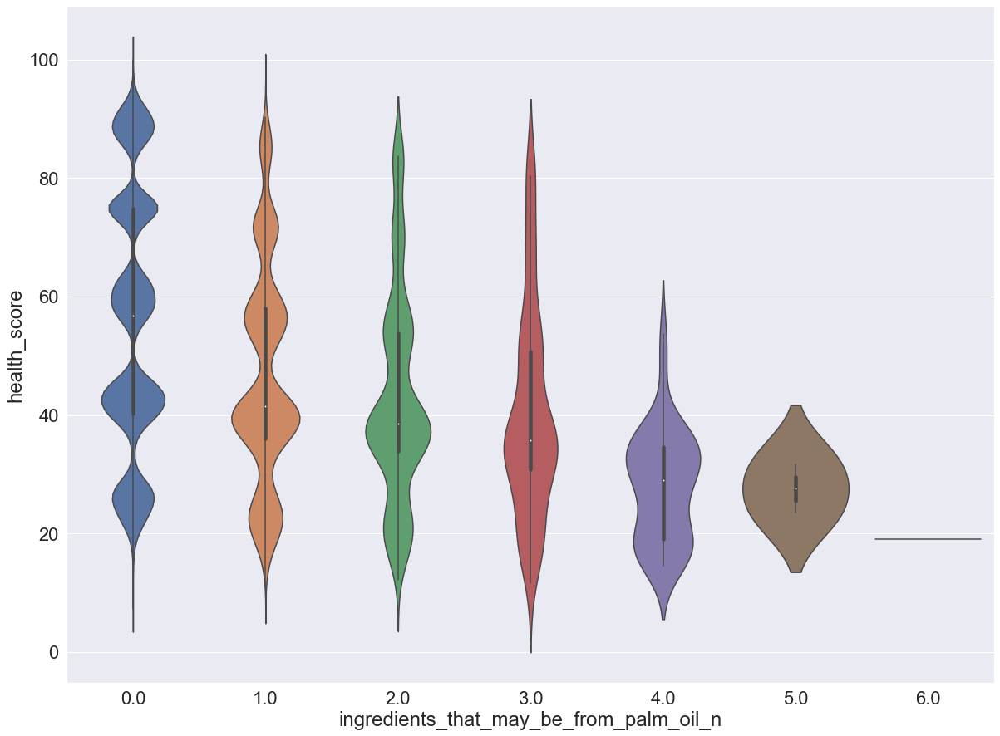

In [24]:
#Créer un sous-ensemble du DataFrame avec les colonnes d'intérêt
subset = df[['health_score', 'ingredients_that_may_be_from_palm_oil_n']].dropna()

#Créer un violinplot
fig, ax = plt.subplots(figsize=(20, 15))
sns.violinplot(x='ingredients_that_may_be_from_palm_oil_n', y='health_score', data=subset)

#Afficher les graphiques
plt.show()

Comme on peut le comprendre à partir du rapport entre le nombre d'additifs dérivés de l'huile de palme et le score de santé, les produits alimentaires ayant un score de santé plus faible contiennent plus d'huile de palme.

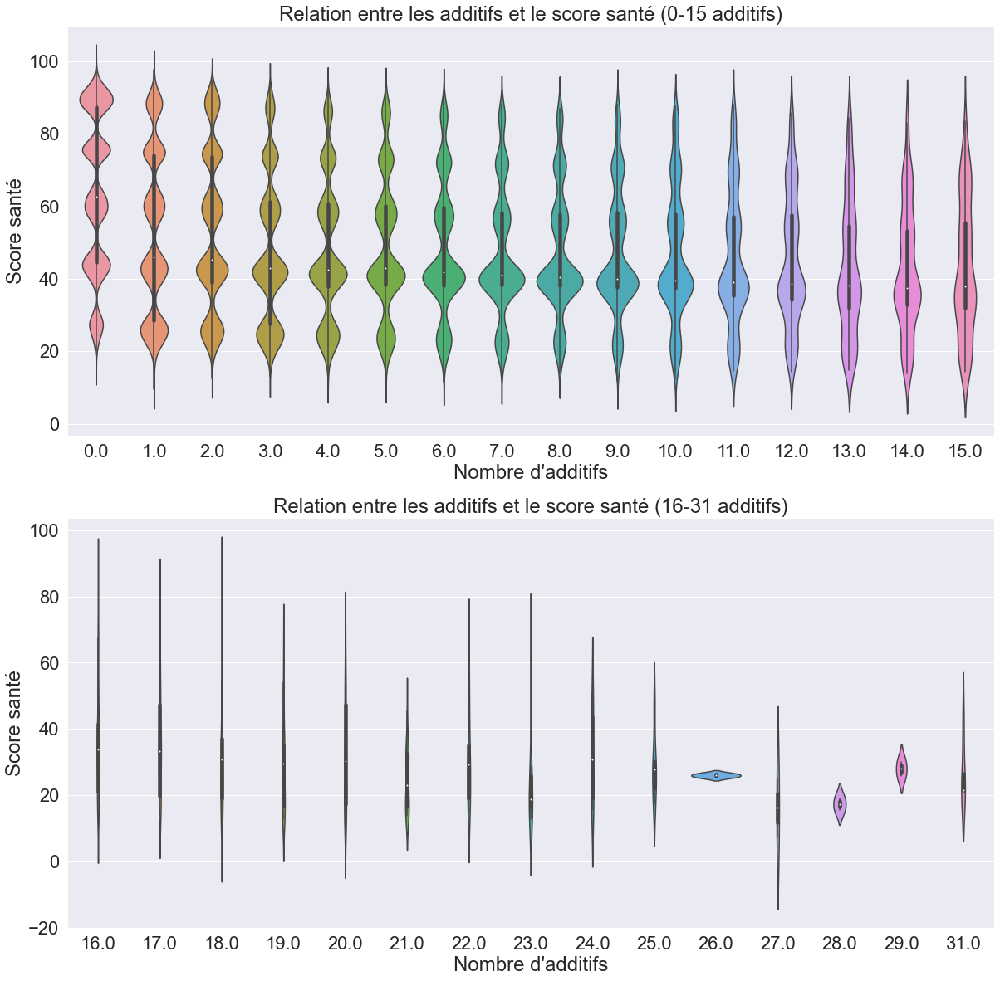

In [25]:
#Définir la taille du graphique
plt.figure(figsize=(20, 20))
plt.rcParams.update({'font.size': 18})

#Créer un subplot avec deux violin plots
plt.subplot(2, 1, 1)
sns.violinplot(x='additives_n', y='health_score', data=df[(df['additives_n'] >= 0) & (df['additives_n'] <= 15)])
plt.title('Relation entre les additifs et le score santé (0-15 additifs)')
plt.xlabel('Nombre d\'additifs')
plt.ylabel('Score santé')

plt.subplot(2, 1, 2)
sns.violinplot(x='additives_n', y='health_score', data=df[(df['additives_n'] >= 16) & (df['additives_n'] <= 31)])
plt.title('Relation entre les additifs et le score santé (16-31 additifs)')
plt.xlabel('Nombre d\'additifs')
plt.ylabel('Score santé')

#Ajuster l'espacement entre les subplots
plt.subplots_adjust(hspace=0.2)

#Afficher le graphique
plt.show()

Il est également similaire lorsque nous regardons la relation entre le nombre d'additifs et le score de santé. À mesure que le nombre d'additifs augmente, le score de santé diminue

In [26]:

# filter dataframe to only include top 100 main_category
top_categories = df['main_category'].value_counts().head(50).index
df_top_categories = df[df['main_category'].isin(top_categories)]

# group by main_category and calculate mean health_score
df_mean = df_top_categories.groupby('main_category', as_index=False)['health_score'].mean()

# sort by mean health_score and keep only top 15 main_category
df_mean_top_15 = df_mean.sort_values('health_score', ascending=False).head(15)

# create boxplot using plotly
fig = px.box(df_top_categories[df_top_categories['main_category'].isin(df_mean_top_15['main_category'])], 
             x='main_category', y='health_score', 
             category_orders={"main_category": df_mean_top_15['main_category']})
fig.show()


#### Eco score

In [27]:
# filter dataframe to only include top 15 labels_tags
top_labels = df['main_category'].value_counts().head(20).index
df_top_labels = df[df['main_category'].isin(top_labels)]

# create boxplot using plotly
fig = px.box(df_top_labels, x='main_category', y='eco_score', 
             category_orders={"main_category": df_top_labels.groupby("main_category")
                                                      .median()["eco_score"]
                                                      .sort_values(ascending=False)
                                                      .index})
fig.show()


Il n'est pas facile de categoriser le score ecologie en fonction du type de categorie principale de l'aliment. C'est pourquoi, cela donne une gamme differente de score ecologique en fonction des differentes valeurs de categorie principale.

#### Package score

In [28]:
# filter dataframe to only include top 50 labels_tags
top_labels = df['labels_tags'].value_counts().head(50).index
df_top_labels = df[df['labels_tags'].isin(top_labels)]

# group by labels_tags and calculate mean package_score
df_mean = df_top_labels.groupby('labels_tags', as_index=False)['package_score'].mean()

# sort by mean package_score and keep only top 15 labels_tags
df_mean_top_15 = df_mean.sort_values('package_score', ascending=False).head(15)

# create boxplot using plotly
fig = px.box(df_top_labels[df_top_labels['labels_tags'].isin(df_mean_top_15['labels_tags'])], 
             x='labels_tags', y='package_score', 
             category_orders={"labels_tags": df_mean_top_15['labels_tags']})
fig.show()


Le score d'emballage nous donne des résultats différents selon le produit. Cependant, la plupart des types d'emballage comprennent du plastique, c'est pourquoi ils ont un score plus bas. Lorsque nous regroupons les valeurs en fonction de l'étiquette sur le produit, nous pouvons voir que la plupart des étiquettes environnementalistes ont un score plus élevé. Par exemple, rainforest-alliance, FSC, société d'agriculture, green-dot. Cela signifie que ce score fonctionne pour deviner les étiquettes respectueuses de l'environnement qui peuvent apparaître sur le produit.

#### Heatmap 

Ce code permet de sélectionner les colonnes numériques d'un DataFrame et de trouver les paires de colonnes qui sont corrélées avec une corrélation supérieure à 0,6. Il est utile pour détecter les colonnes qui peuvent être fortement liées dans les données du projet OpenFoodFact, ce qui peut aider à simplifier les analyses et à éviter la redondance de l'information.

In [29]:
# Sélectionner les colonnes numériques
float_cols = df.select_dtypes(include=['float']).columns.tolist()

# Initialiser une liste pour stocker les paires de colonnes corrélées
paires_correlees = []

# Itérer sur chaque paire de colonnes et calculer la corrélation
for i in range(len(float_cols)):
    for j in range(i+1, len(float_cols)):
        col1 = float_cols[i]
        col2 = float_cols[j]
        corr = df[col1].corr(df[col2])
        
        # Ajouter les paires de colonnes corrélées à la liste si la corrélation est supérieure à 0,7
        if corr > 0.6:
            paires_correlees.append((col1, col2, corr))
            
# Afficher les paires de colonnes corrélées
if len(paires_correlees) > 0:
    print("Paires de colonnes corrélées avec une corrélation supérieure à 0,6:")
    for col1, col2, corr in paires_correlees:
        print(f"{col1} et {col2} ont une corrélation de {corr:.2f}.")



Paires de colonnes corrélées avec une corrélation supérieure à 0,6:
package_score et eco_score ont une corrélation de 0.74.
eco_score et environmental_score ont une corrélation de 0.65.
eco_score et updated_environmental_score ont une corrélation de 0.63.
environmental_score et updated_environmental_score ont une corrélation de 0.90.
energy_100g et fat_100g ont une corrélation de 0.76.
energy_100g et nutrition-score-fr_100g ont une corrélation de 0.64.
energy_100g et nutrition-score-uk_100g ont une corrélation de 0.66.
carbohydrates_100g et sugars_100g ont une corrélation de 0.67.
nutrition-score-fr_100g et nutrition-score-uk_100g ont une corrélation de 0.99.
health_score_1 et health_score_2 ont une corrélation de 0.95.
health_score_1 et health_score ont une corrélation de 0.99.
health_score_2 et health_score ont une corrélation de 0.98.


Ce code sélectionne les colonnes numériques d'un DataFrame et trouve les paires de colonnes qui sont corrélées avec une corrélation supérieure à 0,6. Ensuite, il extrait les noms de colonnes hautement corrélées et sélectionne les données pour ces colonnes. Il calcule ensuite la corrélation entre ces colonnes et les trie par la moyenne des corrélations.

Enfin, le code crée un heatmap avec les données triées par corrélation pour visualiser les relations entre les colonnes hautement corrélées.

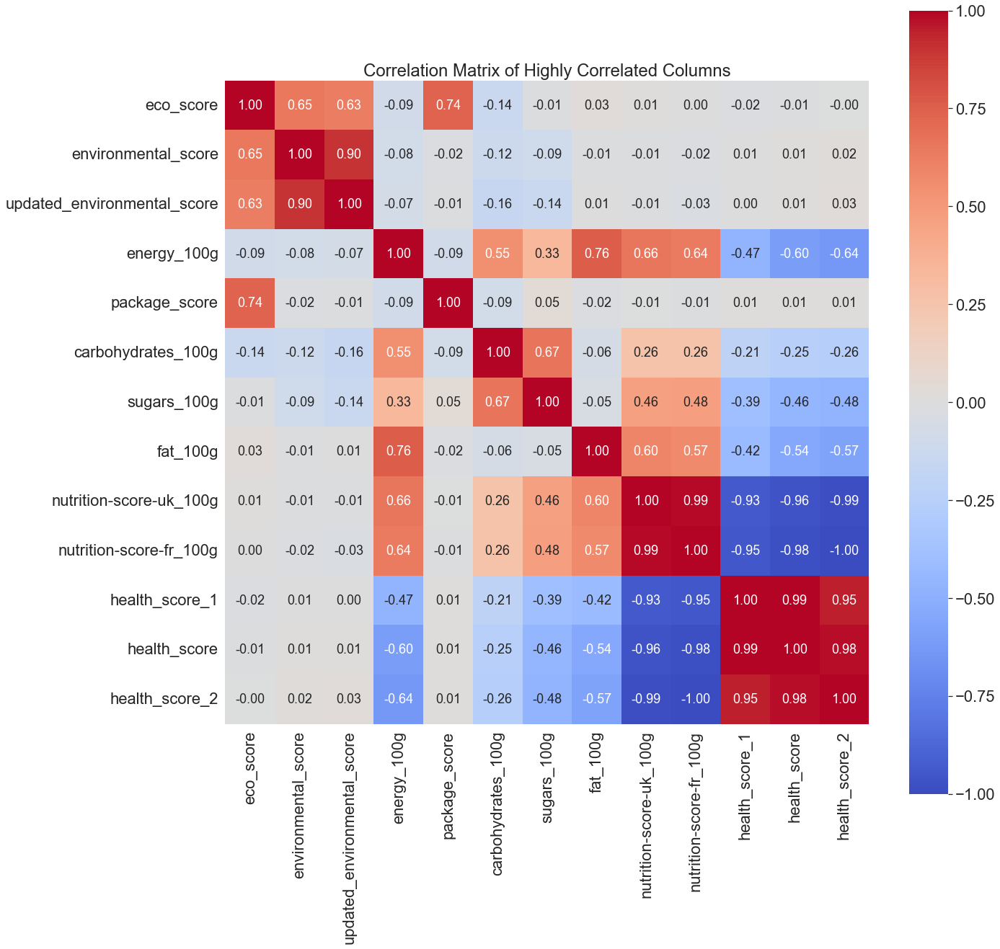

In [30]:
# Sélectionner les colonnes numériques
float_cols = df.select_dtypes(include=['float']).columns.tolist()

# Initialiser une liste pour stocker les paires de colonnes corrélées
paires_correlees = []

# Itérer sur chaque paire de colonnes et calculer la corrélation
for i in range(len(float_cols)):
    for j in range(i+1, len(float_cols)):
        col1 = float_cols[i]
        col2 = float_cols[j]
        corr = df[col1].corr(df[col2])
        
        # Ajouter les paires de colonnes corrélées à la liste si la corrélation est supérieure à 0,6
        if corr > 0.6:
            paires_correlees.append((col1, col2, corr))

# Extraire les noms de colonnes hautement corrélées
correlated_cols = set()
for col1, col2, corr in paires_correlees:
    correlated_cols.add(col1)
    correlated_cols.add(col2)

# Sélectionner les données pour les colonnes hautement corrélées
df_corr = df[list(correlated_cols)]

# Calculer la corrélation et trier par la moyenne des corrélations
corr_matrix = df_corr.corr()
avg_corr = corr_matrix.mean().sort_values(ascending=False).index.tolist()
sorted_corr = corr_matrix.loc[avg_corr, avg_corr]

# Créer un heatmap avec les données triées par corrélation
plt.figure(figsize=(20, 20))
sns.heatmap(sorted_corr, annot=True, cmap='coolwarm', fmt='.2f', square=True)
plt.title('Correlation Matrix of Highly Correlated Columns')
plt.show()


<a id='subsec:Analysemultivariée'></a> 
### Analyse multivariée

L'analyse multivariée permet d'examiner les relations entre plusieurs variables simultanément et de découvrir des modèles ou des tendances qui ne sont pas évidents lors de l'analyse de chaque variable individuellement

In [31]:
# df['nutrition_grade_fr'] = df['nutrition_grade_fr'].str.upper()
colors = {'A': 'darkgreen', 'B': 'lightgreen', 'C': 'yellow', 'D': 'orange', 'E': 'red'}
top_categories = df['main_category'].value_counts().head(10).index

fig = px.box(df[df['main_category'].isin(top_categories)], x='main_category', y='fat_100g', color='nutrition_grade_fr', 
             color_discrete_map=colors, category_orders={"main_category": list(top_categories), 
                                                          "nutrition_grade_fr": ["A", "B", "C", "D", "E"]})

fig.update_layout(title='Box plot of Fat in all categories by Nutrition Grade', xaxis_title='Categories', 
                  yaxis_title="Fat", showlegend=True)

fig.show()

Les produits d'épicerie ont tendance à contenir des taux élevés de matières grasses, suivis des produits en conserve et des chocolats qui en contiennent moins. Il a également été observé que les produits ayant une classification nutritionnelle en rouge et orange ont des taux de matières grasses plus élevés.

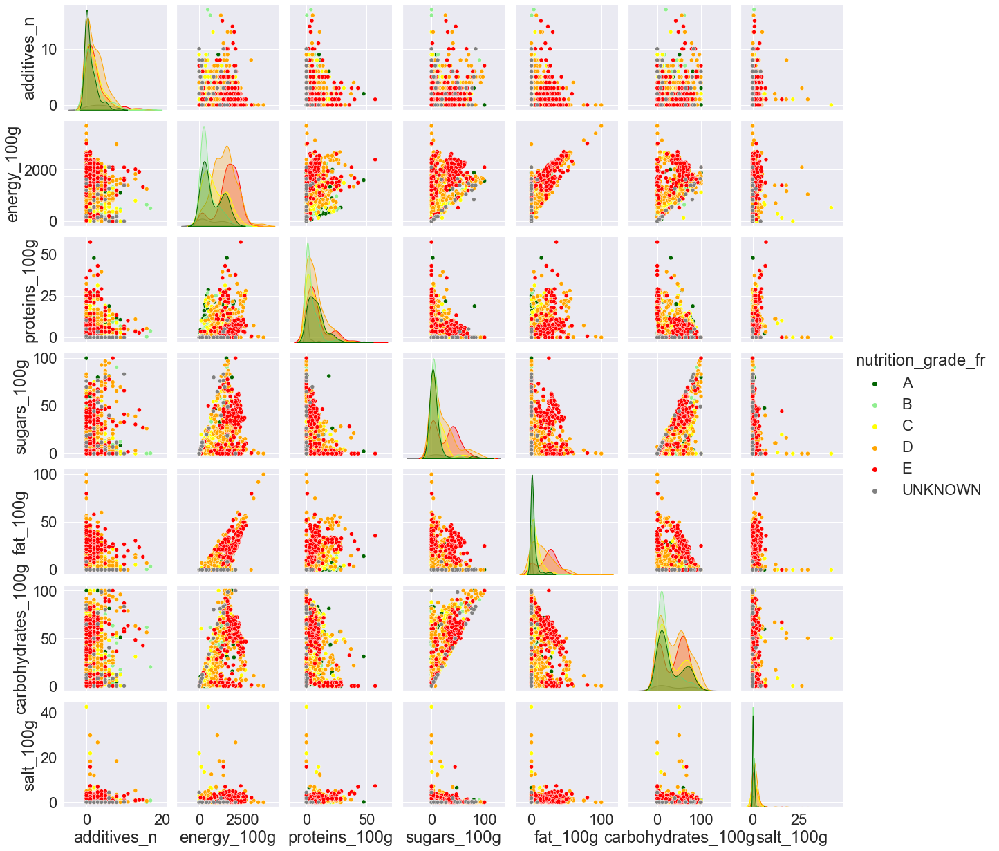

In [32]:
colors = {'A': 'darkgreen', 'B': 'lightgreen', 'C': 'yellow', 'D': 'orange', 'E': 'red', 'UNKNOWN': 'grey'}
palette = [colors[x] for x in sorted(colors.keys())]
plot_cols =  ["additives_n", "energy_100g", "proteins_100g", "sugars_100g", "fat_100g", "carbohydrates_100g", "salt_100g", "nutrition_grade_fr"]
quant_data = df.loc[:,plot_cols]
sns.pairplot(data=quant_data.sample(1000,random_state=0).sort_values(by="nutrition_grade_fr"), hue="nutrition_grade_fr", palette=palette)
plt.show()


Vous pouvez voir la matrice de dispersion de toutes les colonnes numériques de l'ensemble de données, à l'exception des graphiques diagonaux qui sont des graphiques de densité de distribution (KDE). J'ai seulement considéré 1000 données en raison du volume excessif de données dans l'ensemble de données. 

### ACP (Analyse en Composantes Principales)

Cette analyse utilise l'analyse en composantes principales (ACP) pour réduire la dimensionnalité des données en créant de nouvelles variables appelées composantes principales. Ici, les données initiales sont composées de sept colonnes contenant des informations nutritionnelles sur les produits alimentaires. L'objectif est de visualiser les données en deux dimensions en utilisant les deux premières composantes principales pour comprendre les relations entre les variables.

In [33]:
from sklearn import decomposition
from sklearn import preprocessing 

In [34]:
import plotly.graph_objs as go

def display_circles(pcs, n_comp, pca, axis_ranks, labels, label_rotation=-20, lims=(-1.1,1.1)):
    
    for d1, d2 in axis_ranks:
        if d2 < n_comp:

            # initialisation de la figure
            fig = go.Figure()

            for i in range(pcs.shape[1]):
                fig.add_trace(go.Scatter(
                    x=[0, pcs[d1, i]],
                    y=[0, pcs[d2, i]],
                    mode='lines+markers',
                    line=dict(color='grey', width=1),
                    marker=dict(color='blue', size=8),
                    showlegend=False,
                    hoverinfo='none'
                ))

            #ajout des labels (noms des variables)
            txt=[]
            for i, label in enumerate(labels):
                txt.append(dict(
                x=pcs[d1, i],
                y=pcs[d2, i],
                text=label,
                textangle=label_rotation,
                font=dict(color='black', size=20),
                showarrow=False))
                fig.update_layout(
                    annotations=txt,
                    xaxis=dict(
                        range=lims,
                        zeroline=False),
                    yaxis=dict(
                        range=lims,
                        zeroline=False))

            # ajout d'un cercle
            circle = go.Scatter(
                x=np.cos(np.linspace(0, 2 * np.pi, 100)),
                y=np.sin(np.linspace(0, 2 * np.pi, 100)),
                mode='lines',
                line=dict(color='green', width=1),
                showlegend=False)

            fig.add_trace(circle)

            # définition du layout
            fig.update_layout(
                title=dict(text=f"PC{d1+1} vs PC{d2+1}", x=0.5),
                xaxis=dict(title=f"PC{d1+1} ({pca.explained_variance_ratio_[d1]*100:.1f}%)"),
                yaxis=dict(title=f"PC{d2+1} ({pca.explained_variance_ratio_[d2]*100:.1f}%)"),
                height=1000,
                width=1000)

            fig.show()


La fonction display_circles trace les cercles de corrélation pour les deux premières composantes principales et les variables initiales. Cette visualisation permet de visualiser les relations entre les variables et les composantes principales. Les cercles représentent les variables initiales et les flèches représentent les composantes principales. Plus la variable est proche de la circonférence, plus elle est corrélée avec la composante principale.

In [35]:
# Définir les colonnes à utiliser pour l'ACP
filtered_cols = ["additives_n", "energy_100g", "proteins_100g", "sugars_100g", "fat_100g", "carbohydrates_100g", "salt_100g",'nutrition_grade_fr']
X_1 = df.loc[:, filtered_cols].dropna()
X = X_1.drop(['nutrition_grade_fr'],axis =1).values

features = df.loc[:, filtered_cols].columns[:7]
n_comp = 7

# Standardiser les données
std_scale = preprocessing.StandardScaler().fit(X)
X_scaled = std_scale.transform(X)

# Effectuer l'ACP
pca = decomposition.PCA(n_components=n_comp)
pca.fit(X_scaled)

# Récupérer les composantes principales
pcs = pca.components_

# Afficher les cercles de corrélation pour les deux premières composantes principales
display_circles(pcs, n_comp, pca, [(0,1)], labels = np.array(features))


Dans le graphique, les variables "carbohydrates_100g" et "sugars_100g","additives_n" sont corrélées négativement avec les variables "energy_100g" et "fat_100g" sur les deux premières composantes principales, ce qui suggère que les aliments riches en glucides et en sucres ont tendance à être plus faibles en énergie et en gras. D'autre part, la variable "salt_100g" est légèrement corrélée avec les variables "energy_100g" et "carbohydrates_100g", ce qui suggère que les aliments riches en sel ont tendance à être également riches en énergie et en glucides.

In [36]:
# Définir les paires de composantes principales à afficher
pairs = [(0, 1), (1, 2), (2, 3), (3, 4), (4, 5), (5, 6)]

# Boucler à travers chaque paire de composantes principales
for i, pair in enumerate(pairs):
    # Calculer les coordonnées de la sous-figure dans la grille
    row = i // 3 + 1
    col = i % 3 + 1
    
    # Afficher le cercle des corrélations pour la paire de composantes principales
    display_circles(pcs, n_comp, pca, axis_ranks=[pair], labels=features, lims=(-1.1, 1.1), label_rotation=0)


Après avoir visualisé 2 composantes principales et les avoir affichées dans un graphique circulaire, nous avons continué à le faire pour le reste des paires de composantes. Ce qui est intéressant, c'est que lorsque les lignes additives_n et salt_100g se rapprochent de l'arc, le reste des composantes se centralisent au centre du cercle. Cela signifie qu'il n'y a pas de séparation de composantes parfaite pour être en mesure d'inclure la plupart des données tout le temps.

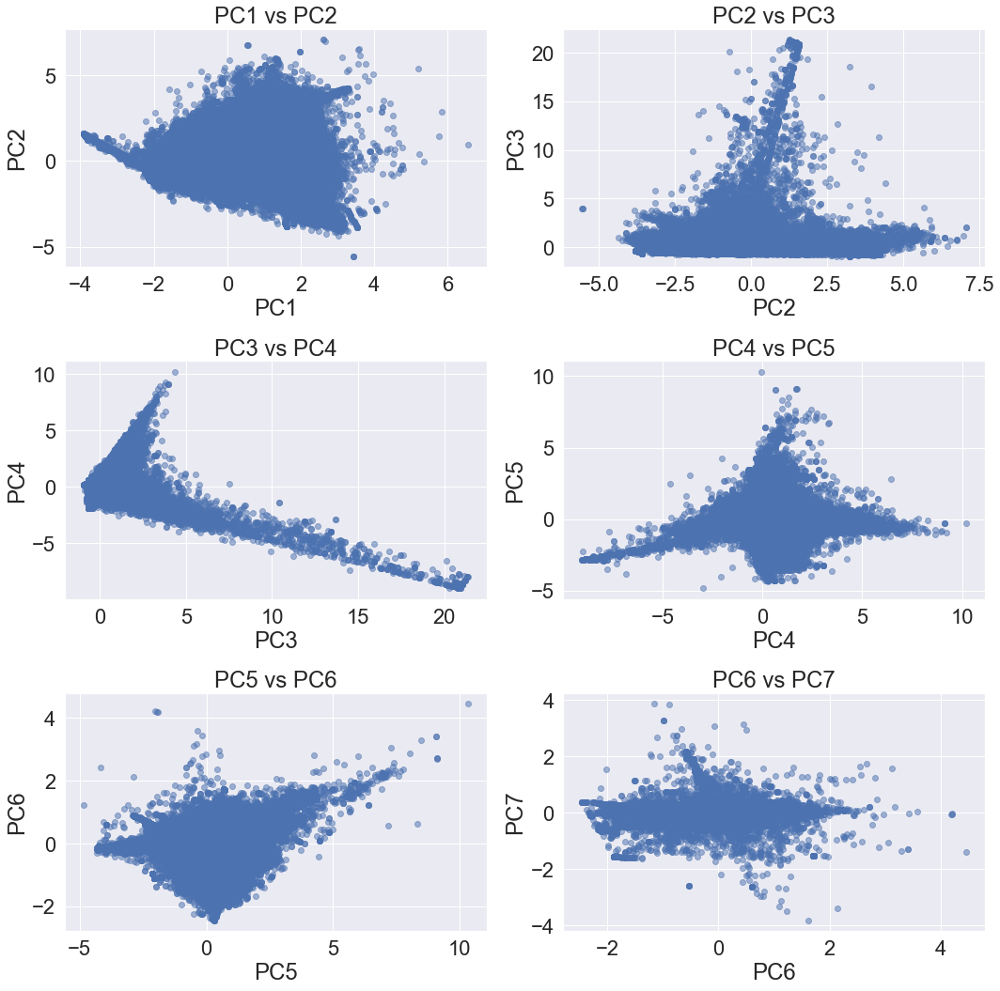

In [37]:
# Définition des paires de composantes principales à tracer
pairs = [(0, 1), (1, 2), (2, 3), (3, 4), (4, 5), (5, 6)]

# Création des sous-graphes
fig, axs = plt.subplots(3, 2, figsize=(15, 15))

# Boucle à travers chaque paire de composantes principales
for i, pair in enumerate(pairs):
    row = i // 2  # détermine le numéro de ligne du sous-graphique en cours de traitement
    col = i % 2   # détermine le numéro de colonne du sous-graphique en cours de traitement
    
    # Tracé des scores des composantes principales
    axs[row, col].scatter(pca.transform(X_scaled)[:, pair[0]], pca.transform(X_scaled)[:, pair[1]], alpha=0.5)
    axs[row, col].set_xlabel("PC{}".format(pair[0]+1))  # ajoute l'étiquette de l'axe x
    axs[row, col].set_ylabel("PC{}".format(pair[1]+1))  # ajoute l'étiquette de l'axe y
    axs[row, col].set_title("PC{} vs PC{}".format(pair[0]+1, pair[1]+1))  # ajoute le titre du sous-graphique

plt.tight_layout()
plt.show()


Cela nous aide à comprendre la structure sous-jacente des données et à identifier les groupes de produits alimentaires qui partagent des caractéristiques similaires. La visualisation de tous les axes principaux nous permet également de comprendre la variabilité des données et de détecter les relations entre les différentes variables. Cela peut aider à identifier les facteurs qui contribuent le plus à la qualité nutritionnelle des produits alimentaires

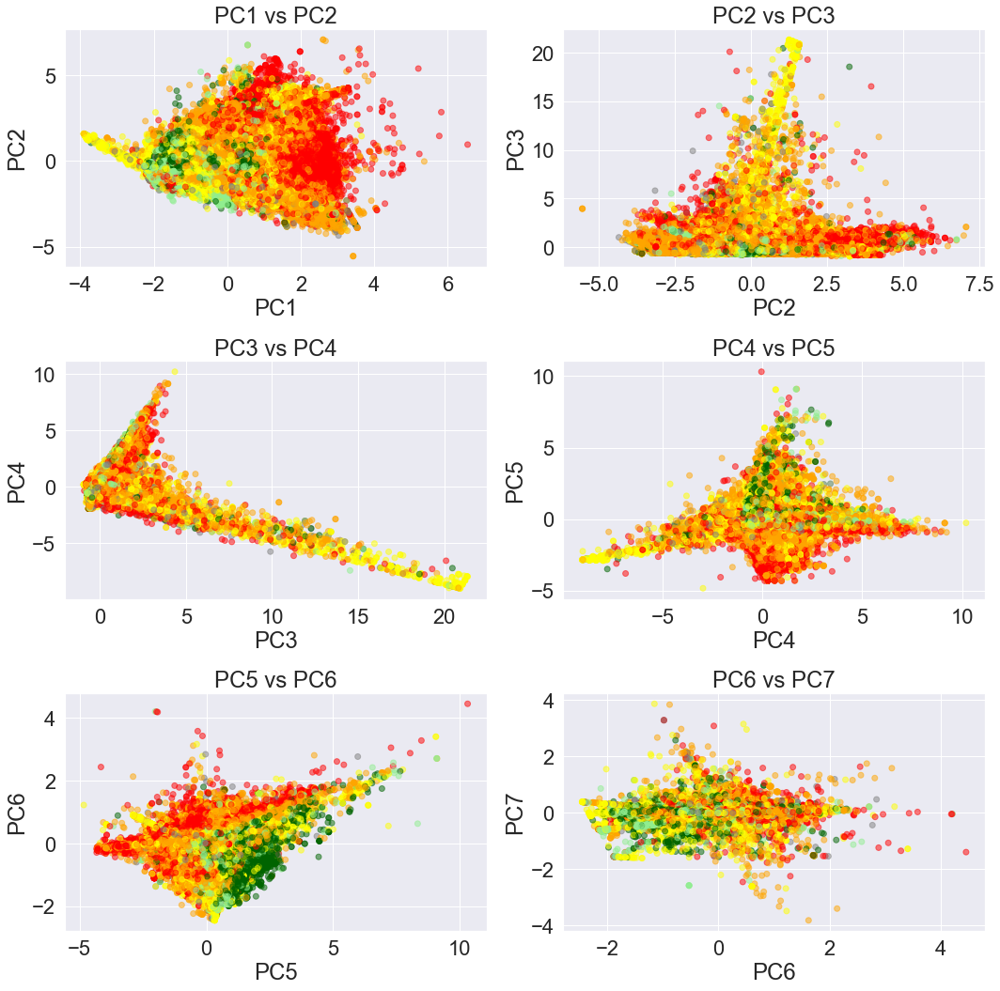

In [38]:
# Définir les paires de composantes principales à tracer
pairs = [(0, 1), (1, 2), (2, 3), (3, 4), (4, 5), (5, 6)]

# Définir les couleurs pour chaque grade nutritionnel
color_dict = {'A': 'darkgreen', 'B': 'lightgreen', 'C': 'yellow', 'D': 'orange', 'E': 'red', 'UNKNOWN': 'grey'}

# Créer des sous-graphiques
fig, axs = plt.subplots(3, 2, figsize=(15, 15))

# Boucler sur chaque paire de composantes principales
for i, pair in enumerate(pairs):
    row = i // 2
    col = i % 2
    
    # Tracer les scores des composantes principales avec une couleur basée sur le grade nutritionnel
    axs[row, col].scatter(pca.transform(X_scaled)[:, pair[0]], pca.transform(X_scaled)[:, pair[1]], 
                          c=[color_dict[x] for x in X_1['nutrition_grade_fr']], alpha=0.5)
    axs[row, col].set_xlabel("PC{}".format(pair[0]+1))
    axs[row, col].set_ylabel("PC{}".format(pair[1]+1))
    axs[row, col].set_title("PC{} vs PC{}".format(pair[0]+1, pair[1]+1))

plt.tight_layout()
plt.show()


Ici, j'ai ajouté le code couleur en fonction de la couleur correspondante de la note nutritionnelle. Sur le graphique PC1 et PC2, nous pouvons voir une distinction entre les données en fonction du code couleur. Le rouge est du côté droit et le vert est du côté gauche. Cette même distinction peut être vue sur les 5ème et 6ème composants. Cependant, il n'y a pas de composant parfait qui puisse séparer les résultats en fonction de la note nutritionnelle. Ils sont tous mélangés d'une certaine manière.

In [39]:
var_ratio = pca.explained_variance_ratio_
var_ratio_cumulative = np.cumsum(var_ratio)

fig = go.Figure()
fig.add_trace(go.Bar(x=list(range(1, len(var_ratio)+1)), y=var_ratio*100,
                     name='Total variance ratio', marker_color='blue'))
fig.add_trace(go.Scatter(x=list(range(1, len(var_ratio)+1)), y=var_ratio_cumulative*100,
                         mode='lines+markers', name='Cumulative variance ratio', marker_color='orange'))
fig.add_hline(y=95, line_color='red', annotation_text='95% of total variance', 
              annotation_position='bottom right')

# Ajouter les pourcentages de chaque composante
for i in range(len(var_ratio)):
    fig.add_annotation(x=i+1, y=var_ratio[i]*100+2, 
                       text=f"{var_ratio[i]*100:.2f}%", showarrow=False, font=dict(size=10))

fig.update_layout(title='Variance ratio per PCA component',
                  xaxis_title='PCA Component', yaxis_title='Variance Ratio (%)', 
                  font=dict(size=12), legend=dict(x=1.05, y=1))
fig.show()


La ligne horizontale à 95% dans le graphique des ratios de variance cumulée est importante car elle indique le pourcentage de variance expliquée par le nombre de composantes principales (PC) sélectionnées. En d'autres termes, cela signifie que si nous utilisons les X premières composantes principales pour décrire les données, nous expliquons 95% de la variance totale de nos données. Cela peut aider à déterminer le nombre optimal de composantes principales à utiliser pour notre analyse, afin de réduire la dimensionnalité de nos données tout en préservant autant d'informations que possible.

<a id='sec:DémonstrationdelapplicationProjetOpenFoodFact'></a>
# Démonstration de l'application : Projet OpenFoodFact

In [40]:
import random

# Choisir un produit au hasard avec des valeurs non nulles pour countries_tags, eco_score, health_score, et package_score
valid_products = df[(df['countries_tags'].notnull()) & 
                    (df['updated_environmental_score'].notnull()) &
                    (df['health_score'].notnull()) & 
                    (df['package_score'].notnull())]

product = valid_products.sample()

# Obtenir le eco_score et les noms de pays correspondants
eco_score = product['updated_environmental_score'].values[0]
country_names = product['countries_tags'].values[0]
package_score = product['package_score'].values[0]
health_score = product['health_score'].values[0]

# Compute the total score
total_score = (eco_score + health_score + package_score) / 3

# Afficher les résultats
print("Product name:", product['product_name'].values[0])
print("Brand name:", product['brands'].values[0])
print("Health score:", health_score.round(2))
print("Eco-score:", eco_score.round(2))
print("Package score: ", package_score)
print("Total score: ", total_score.round(2))


Product name: Chips nature
Brand name: U
Health score: 59.09
Eco-score: 100.0
Package score:  5.0
Total score:  54.7


Ce projet OpenFoodFact est une démonstration de l'application. L'objectif est de traiter et d'analyser les données de produits alimentaires pour en extraire des informations pertinentes telles que les scores de santé, les scores écologiques et les scores de type d'emballage. Le code fourni permet de sélectionner au hasard un produit avec des valeurs non nulles pour ces critères et d'afficher les résultats. Le total score est également calculé en prenant la moyenne des scores de santé, écologiques et de type d'emballage. Ce projet est une démonstration de la façon dont les données peuvent être analysées et utilisées pour fournir des informations utiles pour les consommateurs.

<a id='sec:ConclusionEtPerspectives'></a>
# Conclusion et perspectives

Ce projet consiste à collecter et à analyser des données sur les produits alimentaires afin de fournir aux consommateurs des informations détaillées sur leur contenu et leur impact environnemental.

Nous avons abordé plusieurs aspects du projet, tels que la collecte des données à partir de sources en ligne, le nettoyage et la transformation des données, l'analyse exploratoire et la visualisation des données à l'aide de techniques telles que l'analyse en composantes principales et la représentation graphique en cercle.

De plus, nous avons discuté de l'importance de l'évaluation des produits alimentaires en fonction de leur impact sur la santé, l'environnement et l'emballage. Nous avons également présenté une démonstration de l'application, qui fournit un score total pour chaque produit en utilisant une combinaison de ces évaluations.

Avec ce projet, nous avons appris comment classifier les valeurs nutritionnelles des produits, quels sont les paramètres à prendre en compte et comment remplir les données manquantes. En particulier, nous avons calculé la moyenne des scores de catégorie pour remplir les données manquantes de produits dans chaque catégorie. Cela nous a permis d'obtenir un ensemble de données assez solide. Cependant, certaines données manquaient, comme les noms de lieux de fabrication et d'origine, ce qui rendait impossible leur complétion. C'est pourquoi nous n'avons pas pu remplir complètement les valeurs du score environnemental. Mais en perspective, une fois que ces données seront disponibles, nous pourrons obtenir des résultats encore meilleurs. Nous avons créé le score environnemental en comparant les pays entre eux. Cette méthode pourrait également être appliquée à des niveaux plus fins, tels que les villes et les lieux spécifiques de production. Nous pourrions également travailler sur l'analyse des types de conditionnement pour déterminer combien de temps les produits peuvent être conservés.

En résumé, ce projet démontre l'importance de l'analyse des données dans le domaine de l'alimentation et de la nutrition. Il met en évidence l'impact environnemental des produits alimentaires et fournit des informations précieuses aux consommateurs pour les aider à prendre des décisions éclairées sur leur alimentation.